In [42]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

In [43]:
battery_temp = pd.read_csv('..\Data\BatteryTemperature.csv', header=None, names=['timestamp', 'temperature'])
bus_voltage = pd.read_csv('..\Data\BusVoltage.csv', header=None, names=['timestamp', 'voltage'])
total_bus_current = pd.read_csv('..\Data\TotalBusCurrent.csv', header=None, names=['timestamp', 'current'])
wheel_rpm = pd.read_csv('..\Data\WheelRPM.csv', header=None, names=['timestamp', 'rpm'])
wheel_temp = pd.read_csv('..\Data\WheelTemperature.csv', header=None, names=['timestamp', 'temperature'])

In [44]:
display(battery_temp.head(5))
display(bus_voltage.head(5))
display(total_bus_current.head(5))
display(wheel_rpm.head(5))
display(wheel_temp.head(5))

,timestamp,temperature
0,2004-02-13 15:00:00,3.832011
1,2004-02-13 16:00:00,3.382078
2,2004-02-13 17:00:00,3.848675
3,2004-02-13 18:00:00,3.645655
4,2004-02-13 19:00:00,3.542035


,timestamp,voltage
0,2001-01-21 21:00:00,32.003189
1,2001-01-22 00:00:00,31.943952
2,2001-01-22 03:00:00,32.102344
3,2001-01-22 06:00:00,31.988111
4,2001-01-22 09:00:00,31.945055


,timestamp,current
0,2004-02-13,11.799583
1,2004-02-14,11.826283
2,2004-02-15,11.804309
3,2004-02-16,11.803606
4,2004-02-17,11.239218


,timestamp,rpm
0,2009-05-22 22:30:00,1266.527199
1,2009-05-22 22:35:00,1267.382818
2,2009-05-22 22:40:00,1267.260905
3,2009-05-22 22:45:00,1267.305787
4,2009-05-22 22:50:00,1267.859010


,timestamp,temperature
0,2004-02-13 13:00:00,24.118417
1,2004-02-13 13:10:00,24.118417
2,2004-02-13 13:20:00,24.118417
3,2004-02-13 13:30:00,24.118417
4,2004-02-13 13:40:00,24.118417


In [45]:
# Convert 'timestamp' column to datetime in all dataframes
battery_temp['timestamp'] = pd.to_datetime(battery_temp['timestamp'])
bus_voltage['timestamp'] = pd.to_datetime(bus_voltage['timestamp'])
total_bus_current['timestamp'] = pd.to_datetime(total_bus_current['timestamp'])
wheel_rpm['timestamp'] = pd.to_datetime(wheel_rpm['timestamp'])
wheel_temp['timestamp'] = pd.to_datetime(wheel_temp['timestamp'])

In [46]:


merged_df = battery_temp.merge(bus_voltage, on='timestamp', how='left', suffixes=('_battery', '_bus_voltage'))
merged_df = merged_df.merge(total_bus_current, on='timestamp', how='left', suffixes=('', '_total_bus_current'))
merged_df = merged_df.merge(wheel_rpm, on='timestamp', how='left', suffixes=('', '_wheel_rpm'))
merged_df = merged_df.merge(wheel_temp, on='timestamp', how='left', suffixes=('', '_wheel_temp'))

# Convert 'timestamp' columns to datetime type if they are not already in datetime format
merged_df['timestamp'] = pd.to_datetime(merged_df['timestamp'])
total_bus_current['timestamp'] = pd.to_datetime(total_bus_current['timestamp'])

# Extract date part (YYYY-MM-DD) from the timestamp column in 'total_bus_current' and 'merged_df'
merged_df['date'] = merged_df['timestamp'].dt.date
total_bus_current['date'] = total_bus_current['timestamp'].dt.date

# Merge dataframes using the 'date' column as key
merged_df = merged_df.merge(total_bus_current[['date', 'current']], on='date', how='left', suffixes=('', '_total_bus_current'))

# Now you have the data merged based on the date part, and you can proceed with your analysis.
display(merged_df)

,timestamp,temperature,voltage,current,rpm,temperature_wheel_temp,date,current_total_bus_current
0,2004-02-13 15:00:00,3.832011,32.448689,NaN,NaN,24.118417,2004-02-13,11.799583
1,2004-02-13 16:00:00,3.382078,NaN,NaN,NaN,24.118417,2004-02-13,11.799583
2,2004-02-13 17:00:00,3.848675,NaN,NaN,NaN,24.118417,2004-02-13,11.799583
3,2004-02-13 18:00:00,3.645655,32.449080,NaN,NaN,24.118417,2004-02-13,11.799583
4,2004-02-13 19:00:00,3.542035,NaN,NaN,NaN,24.118417,2004-02-13,11.799583
...,...,...,...,...,...,...,...,...
128284,2018-10-02 19:00:00,0.593578,NaN,NaN,NaN,25.229268,2018-10-02,5.510878
128285,2018-10-02 20:00:00,0.593578,NaN,NaN,NaN,25.229268,2018-10-02,5.510878
128286,2018-10-02 21:00:00,0.593578,NaN,NaN,NaN,25.229268,2018-10-02,5.510878
128287,2018-10-02 22:00:00,0.593578,NaN,NaN,NaN,25.229268,2018-10-02,5.510878


In [47]:
file_path = '../Data/MergedData.csv'
merged_df.to_csv(file_path, index=False)

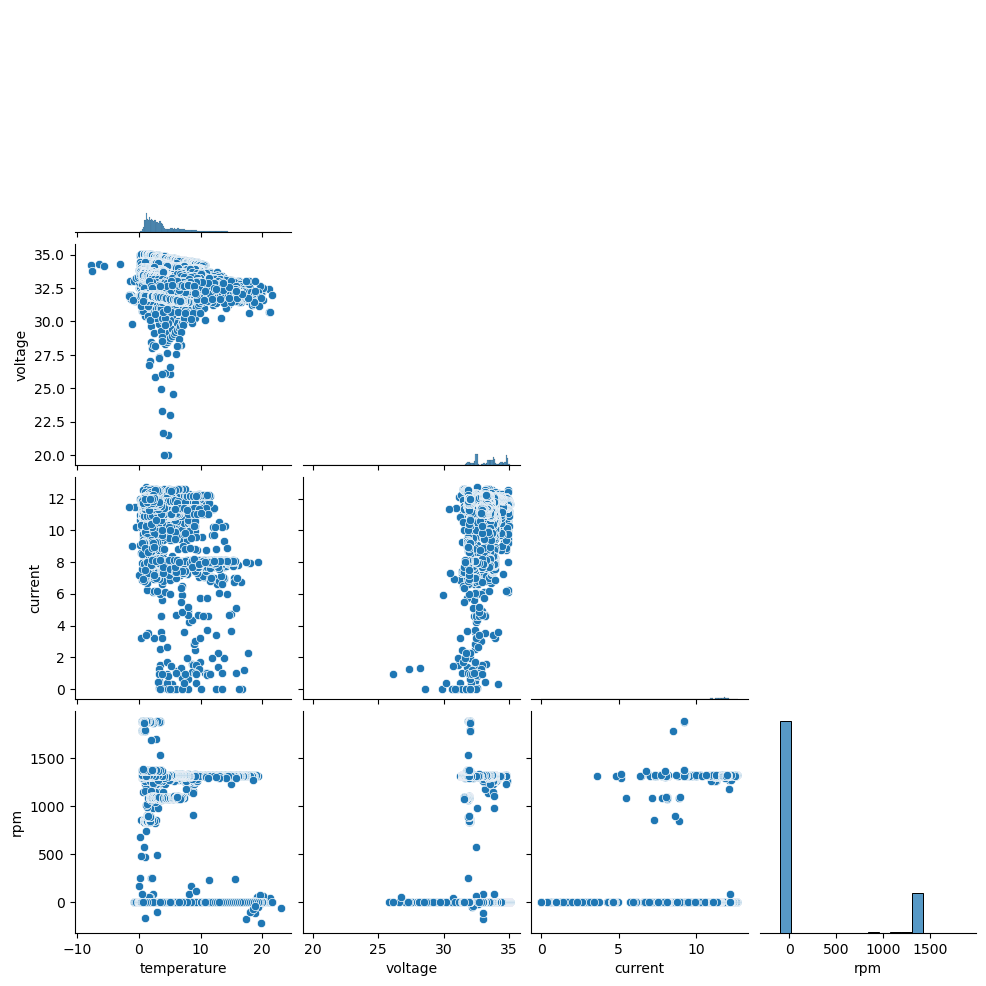

In [48]:
sns.pairplot(merged_df, vars=['temperature', 'voltage', 'current', 'rpm'], corner=True)

In [49]:
missing_values = merged_df.isnull().sum()
print(missing_values)

timestamp                         0
temperature                       0
voltage                       85527
current                      122944
rpm                           46213
temperature_wheel_temp            0
date                              0
current_total_bus_current         0
dtype: int64


In [50]:
# Fill with mean
merged_df.fillna(merged_df.mean(), inplace=True)

C:\Users\londo\AppData\Local\Temp\ipykernel_31596\4286515361.py:2: FutureWarning:

DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.

C:\Users\londo\AppData\Local\Temp\ipykernel_31596\4286515361.py:2: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.



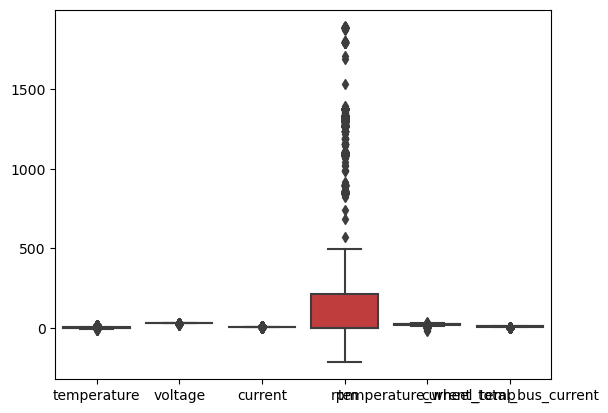

In [51]:
sns.boxplot(data=merged_df)
plt.show()

In [52]:
# Remove rows with negative values in any numeric column
merged_df = merged_df[(merged_df.select_dtypes(include=['float64', 'int64']) >= 0).all(axis=1)]

In [53]:
from scipy import stats
# Select only the numeric columns
numeric_cols = merged_df.select_dtypes(include=['float64', 'int64'])

# Compute Z-scores for the numeric columns
z_scores = stats.zscore(numeric_cols)
display("Z-scores:")
display(z_scores)
abs_z_scores = np.abs(z_scores)

'Z-scores:'

,temperature,voltage,current,rpm,temperature_wheel_temp,current_total_bus_current
0,-0.018220,-1.633437,-0.000124,-0.000152,0.071078,0.465853
1,-0.167107,-0.000902,-0.000124,-0.000152,0.071078,0.465853
2,-0.012705,-0.000902,-0.000124,-0.000152,0.071078,0.465853
3,-0.079887,-1.632769,-0.000124,-0.000152,0.071078,0.465853
4,-0.114176,-0.000902,-0.000124,-0.000152,0.071078,0.465853
...,...,...,...,...,...,...
128284,-1.089852,-0.000902,-0.000124,-0.000152,0.452841,-3.209573
128285,-1.089852,-0.000902,-0.000124,-0.000152,0.452841,-3.209573
128286,-1.089852,-0.000902,-0.000124,-0.000152,0.452841,-3.209573
128287,-1.089852,-0.000902,-0.000124,-0.000152,0.452841,-3.209573


In [54]:
outliers = (abs_z_scores > 2).any(axis=1)

In [55]:
display(outliers)

0         False
1         False
2         False
3         False
4         False
          ...  
128284     True
128285     True
128286     True
128287     True
128288     True
Length: 128131, dtype: bool

In [56]:
merged_df = merged_df[merged_df['timestamp'] >= '2010-01-01']

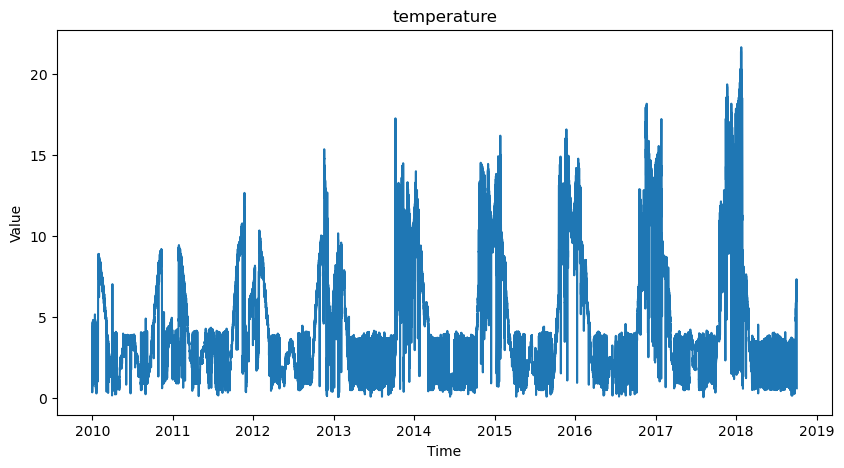

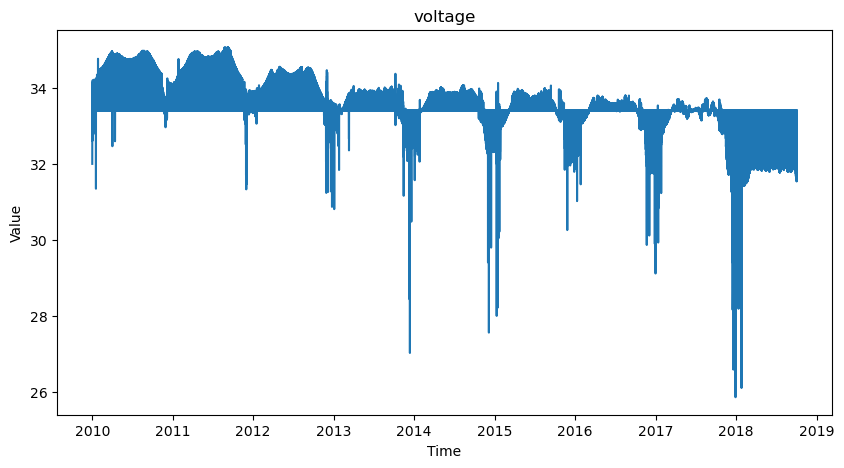

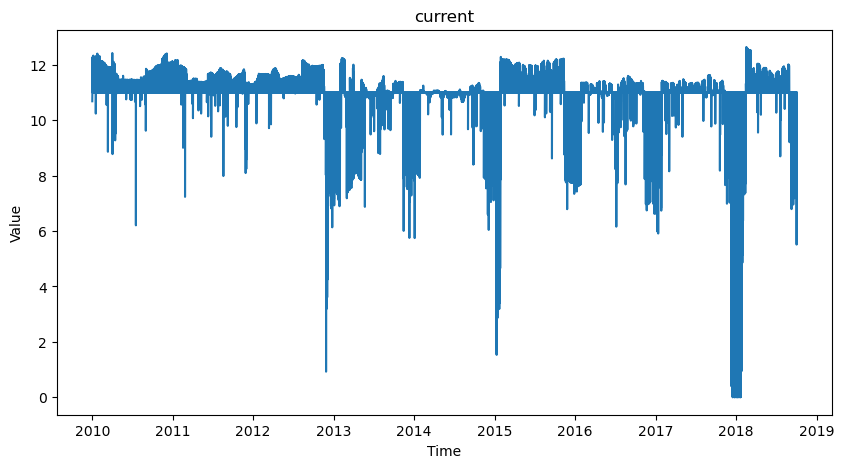

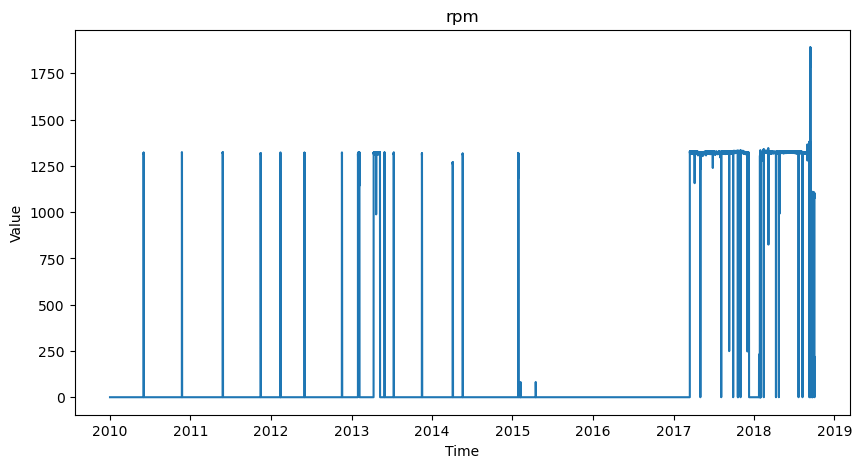

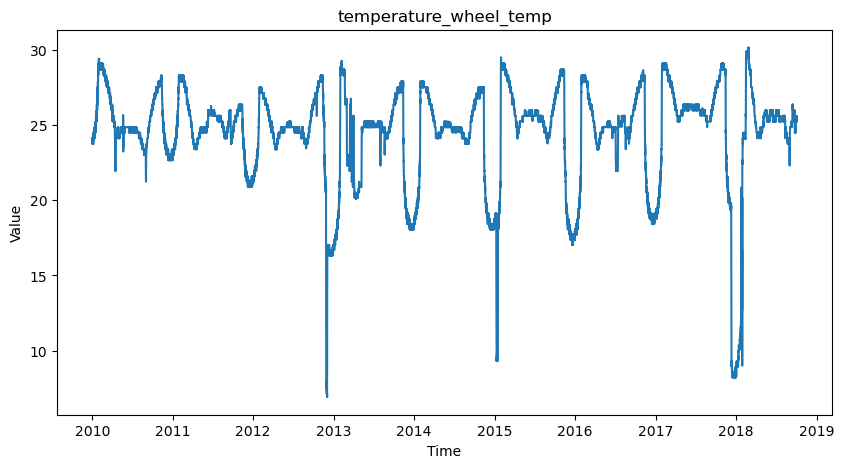

In [57]:
import matplotlib.pyplot as plt

# Assuming 'time' is the name of the column with time values
time_column = merged_df['timestamp']

# Get the numeric columns (excluding the time column if it's numeric)
numeric_cols = merged_df.select_dtypes(include=['float64', 'int64']).drop(columns=['time'] if 'time' in merged_df.select_dtypes(include=['float64', 'int64']).columns else [])

# Plot the graphs
for col in numeric_cols.columns[:5]:  # Change this to limit the number of graphs
    plt.figure(figsize=(10, 5))
    plt.plot(time_column, merged_df[col])
    plt.title(col)
    plt.xlabel('Time')
    plt.ylabel('Value')
    plt.show()

In [58]:
merged_df.describe()

,temperature,voltage,current,rpm,temperature_wheel_temp,current_total_bus_current
count,76698.000000,76698.000000,76698.000000,76698.000000,76698.000000,76698.000000
mean,4.326418,33.461806,10.984564,231.742402,24.458059,10.628786
std,3.531305,0.522260,0.411861,501.995407,3.380490,1.982175
min,0.039825,25.853323,0.000000,0.000000,6.911317,0.000000
25%,1.708204,33.404206,11.000077,0.000000,24.118417,10.827750
50%,3.062064,33.404206,11.000077,0.000000,24.857049,11.344038
75%,6.306627,33.404206,11.000077,0.000000,26.358480,11.680182
max,21.630619,35.065620,12.636613,1890.925536,30.164982,12.636613


In [59]:
merged_df.head()

,timestamp,temperature,voltage,current,rpm,temperature_wheel_temp,date,current_total_bus_current
51561,2010-01-01 00:00:00,1.777310,31.995432,10.684920,0.0,24.079831,2010-01-01,10.68492
51562,2010-01-01 01:00:00,0.340756,33.404206,11.000077,0.0,24.118417,2010-01-01,10.68492
51563,2010-01-01 02:00:00,3.366016,33.404206,11.000077,0.0,24.118417,2010-01-01,10.68492
51564,2010-01-01 03:00:00,4.070266,33.761568,11.000077,0.0,23.751850,2010-01-01,10.68492
51565,2010-01-01 04:00:00,3.277116,33.404206,11.000077,0.0,23.751850,2010-01-01,10.68492


C:\Users\londo\AppData\Local\Temp\ipykernel_31596\3763189727.py:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



,temperature,voltage,current,rpm,temperature_wheel_temp,current_total_bus_current
temperature,1.000000,-0.231845,-0.089494,-0.128140,-0.310430,-0.452937
voltage,-0.231845,1.000000,0.166875,-0.255794,0.201667,0.278375
current,-0.089494,0.166875,1.000000,0.007326,0.167721,0.201022
rpm,-0.128140,-0.255794,0.007326,1.000000,0.144777,0.040658
temperature_wheel_temp,-0.310430,0.201667,0.167721,0.144777,1.000000,0.839730
current_total_bus_current,-0.452937,0.278375,0.201022,0.040658,0.839730,1.000000


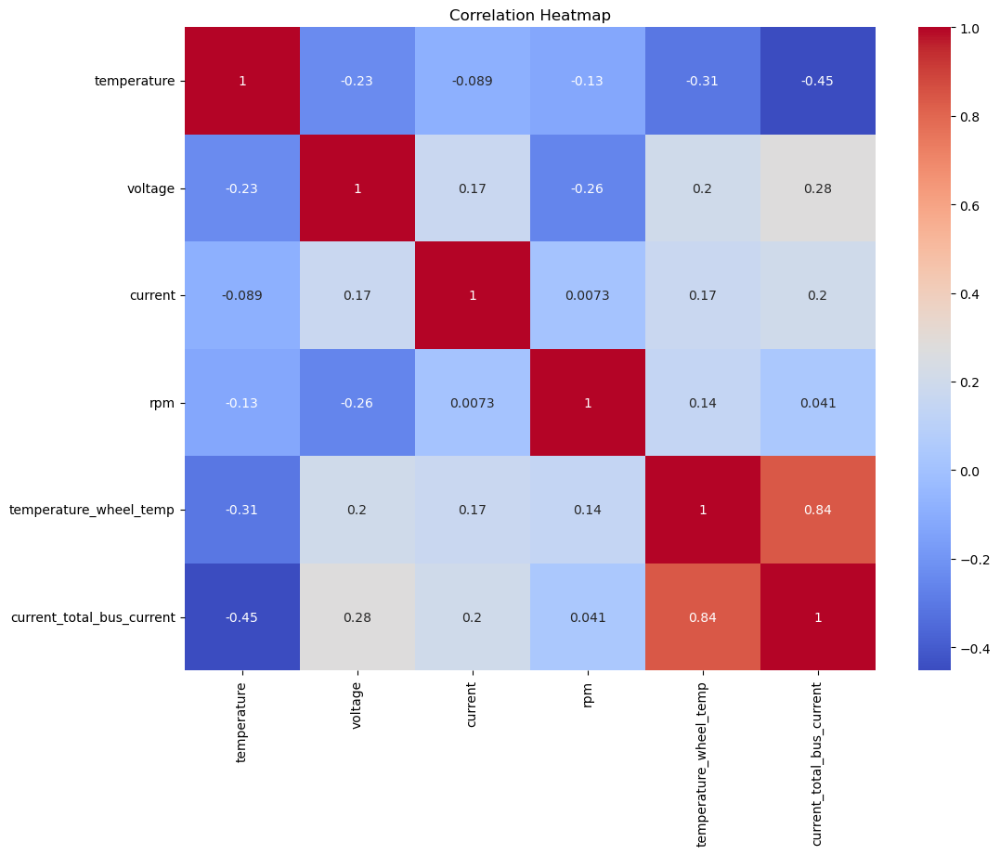

In [60]:
# corr matrix
correlation_matrix = merged_df.corr()
display(correlation_matrix)

plt.figure(figsize=(12, 9))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()


In [61]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Ridge, Lasso
from sklearn.metrics import mean_squared_error

In [62]:
# Define your features and target variable
X = merged_df[['voltage', 'current', 'rpm', 'temperature_wheel_temp', 'current_total_bus_current']]
y = merged_df['temperature']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [63]:
# Create a Ridge regressor object
ridge_regressor = Ridge(alpha=1.0) # You can change alpha to apply different levels of regularization

# Fit the model to the data
ridge_regressor.fit(X_train, y_train)

# Predict on the test data
y_pred_ridge = ridge_regressor.predict(X_test)

# Compute the mean squared error
mse_ridge = mean_squared_error(y_test, y_pred_ridge)
print("Ridge Regression Mean Squared Error:", mse_ridge)

Ridge Regression Mean Squared Error: 9.128150829197459


In [64]:
# Create a Lasso regressor object
lasso_regressor = Lasso(alpha=1.0) # You can change alpha to apply different levels of regularization

# Fit the model to the data
lasso_regressor.fit(X_train, y_train)

# Predict on the test data
y_pred_lasso = lasso_regressor.predict(X_test)

# Compute the mean squared error
mse_lasso = mean_squared_error(y_test, y_pred_lasso)
print("Lasso Regression Mean Squared Error:", mse_lasso)

Lasso Regression Mean Squared Error: 9.902840030489237


In [65]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Add a constant term for the intercept
X = add_constant(merged_df[['temperature', 'voltage', 'current', 'rpm', 'temperature_wheel_temp', 'current_total_bus_current']])

# Compute VIF for each feature
vif = pd.DataFrame()
vif['Feature'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

print(vif)

                     Feature          VIF
0                      const  5202.494652
1                temperature     1.356232
2                    voltage     1.227923
3                    current     1.058548
4                        rpm     1.176215
5     temperature_wheel_temp     3.652103
6  current_total_bus_current     4.171288


In [66]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Transform rpm into binary outcome
merged_df['is_spinning'] = (merged_df['rpm'] > 0).astype(int)

# Define your features and target variable
X = merged_df[['temperature', 'voltage', 'current', 'temperature_wheel_temp', 'current_total_bus_current']]
y = merged_df['is_spinning']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a logistic regression object
logistic_regressor = LogisticRegression()

# Fit the model to the data
logistic_regressor.fit(X_train, y_train)

# Predict on the test data
y_pred_logistic = logistic_regressor.predict(X_test)

# Compute the accuracy score
accuracy = accuracy_score(y_test, y_pred_logistic)
print("Logistic Regression Accuracy:", accuracy)

Logistic Regression Accuracy: 0.8500651890482399


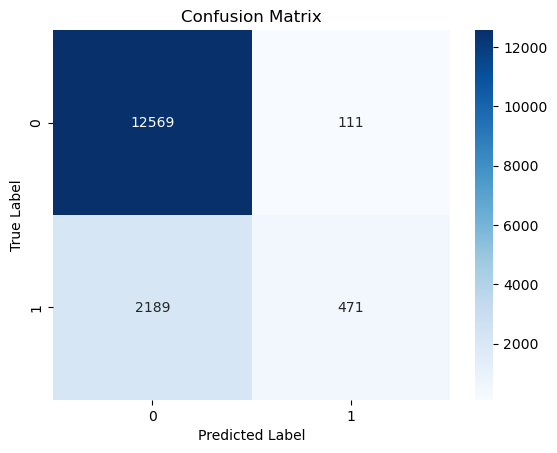

In [67]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

y_pred = logistic_regressor.predict(X_test)
cm = confusion_matrix(y_test, y_pred)

sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.title('Confusion Matrix')
plt.show()

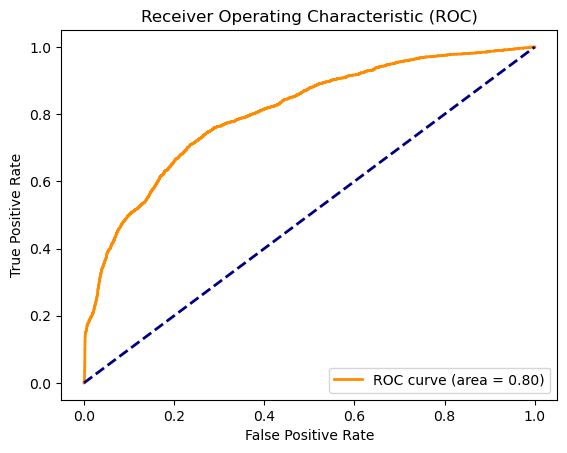

In [68]:
from sklearn.metrics import roc_curve, auc
from sklearn.linear_model import LogisticRegression

# Assume X_train and y_train are your training data
model = LogisticRegression()
model.fit(X_train, y_train)

# Assume X_test is your test data
y_pred_prob = model.predict_proba(X_test)[:, 1]

fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob) # Use y_pred_prob instead of accuracy
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc='lower right')
plt.show()

In [69]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 76698 entries, 51561 to 128288
Data columns (total 9 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   timestamp                  76698 non-null  datetime64[ns]
 1   temperature                76698 non-null  float64       
 2   voltage                    76698 non-null  float64       
 3   current                    76698 non-null  float64       
 4   rpm                        76698 non-null  float64       
 5   temperature_wheel_temp     76698 non-null  float64       
 6   date                       76698 non-null  object        
 7   current_total_bus_current  76698 non-null  float64       
 8   is_spinning                76698 non-null  int32         
dtypes: datetime64[ns](1), float64(6), int32(1), object(1)
memory usage: 5.6+ MB


In [70]:
merged_df.drop('date', axis=1, inplace=True)

In [71]:
import pandas as pd

# Assuming you have a DataFrame named 'df'
# To rename the 'old_column_name' to 'new_column_name', use the rename method
merged_df.rename(columns={'temperature_wheel_temp': 'wheel_temp'}, inplace=True)
merged_df.rename(columns={'current_total_bus_current': 'daily_total_bus_current'}, inplace=True)

display(merged_df)

,timestamp,temperature,voltage,current,rpm,wheel_temp,daily_total_bus_current,is_spinning
51561,2010-01-01 00:00:00,1.777310,31.995432,10.684920,0.00000,24.079831,10.684920,0
51562,2010-01-01 01:00:00,0.340756,33.404206,11.000077,0.00000,24.118417,10.684920,0
51563,2010-01-01 02:00:00,3.366016,33.404206,11.000077,0.00000,24.118417,10.684920,0
51564,2010-01-01 03:00:00,4.070266,33.761568,11.000077,0.00000,23.751850,10.684920,0
51565,2010-01-01 04:00:00,3.277116,33.404206,11.000077,0.00000,23.751850,10.684920,0
...,...,...,...,...,...,...,...,...
128284,2018-10-02 19:00:00,0.593578,33.404206,11.000077,217.33543,25.229268,5.510878,1
128285,2018-10-02 20:00:00,0.593578,33.404206,11.000077,217.33543,25.229268,5.510878,1
128286,2018-10-02 21:00:00,0.593578,33.404206,11.000077,217.33543,25.229268,5.510878,1
128287,2018-10-02 22:00:00,0.593578,33.404206,11.000077,217.33543,25.229268,5.510878,1


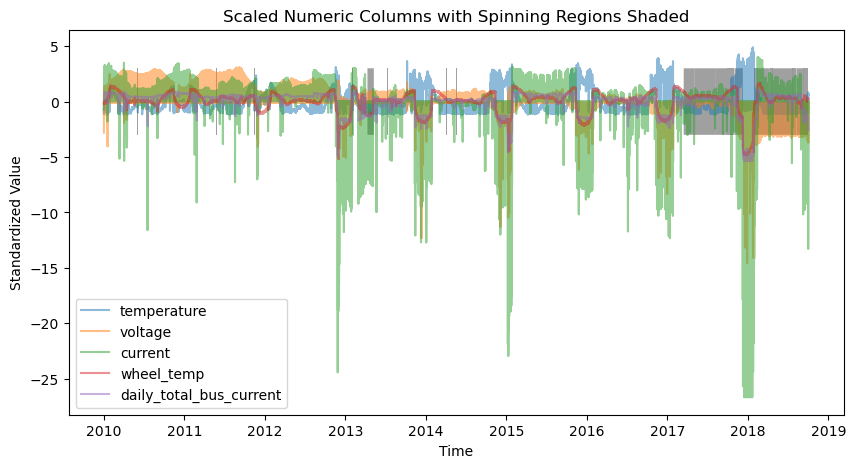

In [72]:
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# Assuming 'timestamp' is the name of the column with time values
time_column = merged_df['timestamp']

# Get the numeric columns (excluding the time and rpm columns if they're numeric)
numeric_cols = merged_df.select_dtypes(include=['float64', 'int64']).drop(columns=['time', 'rpm'] if 'time' in merged_df.select_dtypes(include=['float64', 'int64']).columns else ['rpm'])

# Scale the numeric columns
scaler = StandardScaler()
scaled_values = scaler.fit_transform(numeric_cols)

# Plot all numeric columns on the same graph (excluding rpm)
plt.figure(figsize=(10, 5))
for i, col in enumerate(numeric_cols.columns[:6]):  # Change this to limit the number of graphs
    plt.plot(time_column, scaled_values[:, i], label=col, alpha=0.5) # Reduced alpha

# Shade regions where 'rpm' is non-zero
rpm_column = merged_df['rpm']
where_rpm_non_zero = rpm_column != 0
plt.fill_between(time_column, -3, 3, where=where_rpm_non_zero, alpha=0.75, facecolor='grey')  # Change facecolor if needed and adjusted alpha
plt.title('Scaled Numeric Columns with Spinning Regions Shaded')
plt.xlabel('Time')
plt.ylabel('Standardized Value')
plt.legend()
plt.show()

In [73]:
import plotly.express as px
import pandas as pd
from sklearn.preprocessing import StandardScaler

numeric_cols = merged_df.select_dtypes(include=['float64', 'int64'])
cols_to_drop = ['timestamp', 'rpm']
numeric_cols = numeric_cols.drop(columns=[col for col in cols_to_drop if col in numeric_cols.columns])

# Scale the numeric columns
scaler = StandardScaler()
scaled_values = scaler.fit_transform(numeric_cols)

# Create a DataFrame for the scaled values
scaled_df = pd.DataFrame(scaled_values, columns=numeric_cols.columns)
scaled_df['timestamp'] = merged_df['timestamp']

# Create a figure
fig = px.line()

# Add the lines for each numeric column (excluding rpm)
for col in scaled_df.columns[:-1]:
    fig.add_scatter(x=scaled_df['timestamp'], y=scaled_df[col], name=col)

# Add shading where 'rpm' is non-zero
rpm_column = merged_df['rpm']
where_rpm_non_zero = rpm_column != 0
fig.add_scatter(x=merged_df['timestamp'], y=where_rpm_non_zero * 3 - 3, fill='toself', fillcolor='grey', opacity=0.1, name='rpm_non_zero')

# Customize the appearance
fig.update_traces(line=dict(width=2))
fig.update_layout(
    title='Scaled Numeric Columns with Spinning Regions Shaded',
    xaxis_title='Time',
    yaxis_title='Standardized Value',
)

# Show the plot
fig.show()

In [74]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping


In [94]:
data = pd.read_csv('..\Data\MergedData.csv')
display(data.head(1))
data = data.drop(['timestamp'], axis=1)
data = data.drop(['date'], axis=1)
data['rpm'] = data['rpm'].fillna(0)
display(data.head(1))
data['voltage'] = data['voltage'].fillna(data['voltage'].rolling(window=5, min_periods=1).mean())
data['current'] = data['current'].fillna(data['current'].rolling(window=5, min_periods=1).mean())
data['voltage'] = data['voltage'].fillna(data['voltage'].rolling(window=5, min_periods=1).mean().shift(-4))
data['current'] = data['current'].fillna(data['current'].rolling(window=5, min_periods=1).mean().shift(-4))

print(data.isnull().sum())
display(data)

,timestamp,temperature,voltage,current,rpm,temperature_wheel_temp,date,current_total_bus_current
0,2004-02-13 15:00:00,3.832011,32.448689,NaN,NaN,24.118417,2004-02-13,11.799583


,temperature,voltage,current,rpm,temperature_wheel_temp,current_total_bus_current
0,3.832011,32.448689,NaN,0.0,24.118417,11.799583


temperature                      0
voltage                          1
current                      80184
rpm                              0
temperature_wheel_temp           0
current_total_bus_current        0
dtype: int64


,temperature,voltage,current,rpm,temperature_wheel_temp,current_total_bus_current
0,3.832011,32.448689,NaN,0.0,24.118417,11.799583
1,3.382078,32.448689,NaN,0.0,24.118417,11.799583
2,3.848675,32.448689,NaN,0.0,24.118417,11.799583
3,3.645655,32.449080,NaN,0.0,24.118417,11.799583
4,3.542035,32.448884,NaN,0.0,24.118417,11.799583
...,...,...,...,...,...,...
128284,0.593578,31.544304,NaN,0.0,25.229268,5.510878
128285,0.593578,31.536154,NaN,0.0,25.229268,5.510878
128286,0.593578,31.536154,NaN,0.0,25.229268,5.510878
128287,0.593578,31.536154,NaN,0.0,25.229268,5.510878


In [97]:
data['voltage'] = data['voltage'].fillna(data['voltage'].rolling(window=5, min_periods=1).mean())
data['current'] = data['current'].fillna(data['current'].rolling(window=5, min_periods=1).mean())
data['voltage'] = data['voltage'].fillna(data['voltage'].rolling(window=5, min_periods=1).mean().shift(-4))
data['current'] = data['current'].fillna(data['current'].rolling(window=5, min_periods=1).mean().shift(-4))
data = data.dropna()

print(data.isnull().sum())

temperature                  0
voltage                      0
current                      0
rpm                          0
temperature_wheel_temp       0
current_total_bus_current    0
dtype: int64


In [98]:
# Split data into features (X) and target (y)
X = data.drop('rpm', axis=1)
y = data['rpm']

# Scale data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X_scaled, y, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)


In [99]:
model = Sequential()
model.add(Dense(32, input_dim=X_train.shape[1], activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(16, activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(1, activation='linear'))  # Use 'sigmoid' for binary classification

model.compile(optimizer='adam', loss='mse')  # Use 'binary_crossentropy' for binary classification


In [100]:
early_stop = EarlyStopping(monitor='val_loss', patience=10)
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_val, y_val), callbacks=[early_stop])


Epoch 1/100
2807/2807 [==============================] - 2s 631us/step - loss: 123108.6719 - val_loss: 90407.1641
Epoch 2/100
2807/2807 [==============================] - 2s 607us/step - loss: 95290.4062 - val_loss: 82602.5234
Epoch 3/100
2807/2807 [==============================] - 2s 607us/step - loss: 89947.2500 - val_loss: 79563.3828
Epoch 4/100
2807/2807 [==============================] - 2s 603us/step - loss: 87717.6641 - val_loss: 78158.2031
Epoch 5/100
2807/2807 [==============================] - 2s 596us/step - loss: 86191.0000 - val_loss: 76506.6562
Epoch 6/100
2807/2807 [==============================] - 2s 597us/step - loss: 85264.2812 - val_loss: 75177.3984
Epoch 7/100
2807/2807 [==============================] - 2s 600us/step - loss: 83550.2188 - val_loss: 74020.1562
Epoch 8/100
2807/2807 [==============================] - 2s 600us/step - loss: 82994.0469 - val_loss: 72916.3906
Epoch 9/100
2807/2807 [==============================] - 2s 612us/step - loss: 81818.0703 - val

In [101]:
loss = model.evaluate(X_test, y_test)
print(f"Test Loss: {loss}")


602/602 [==============================] - 0s 410us/step - loss: 60013.0547
Test Loss: 60013.0546875


In [102]:
predictions = model.predict(X_test)


602/602 [==============================] - 0s 359us/step


In [103]:
print(predictions[:10])  # This will print the first 10 predictions.


[[  17.27286 ]
 [  17.27286 ]
 [  17.27286 ]
 [ 687.7188  ]
 [  17.27286 ]
 [  95.374954]
 [  17.27286 ]
 [1124.0548  ]
 [  17.27286 ]
 [ 743.5752  ]]
